In [20]:
%load_ext autoreload
%autoreload 2

In [1]:
import pyro
from pyro.infer import MCMC, NUTS, HMC
from functools import partial
import ot

In [2]:
import os, sys
cwd = os.getcwd()

api_path = os.path.join(cwd, '..', 'tools')
models_path = os.path.join(cwd, '..', 'models_25gaussians', 'jensen_minimax')
sys.path.append(api_path)

In [21]:
import numpy as np
import sklearn.datasets
import time
import random
import glob
from tqdm import tqdm

from matplotlib import pyplot as plt

import torch, torch.nn as nn
import torch.nn.functional as F

from torch.autograd import Variable
from torch import autograd
from torch.distributions import MultivariateNormal, Normal, Independent, Uniform

from utils import (Evolution,
                   prepare_25gaussian_data, 
                   prepare_swissroll_data,
                   prepare_gaussians,
                   prepare_train_batches,
                   prepare_dataloader,
                   logging)
from gan_fc_models import (Generator_fc, 
                           Discriminator_fc, 
                           weights_init_1, 
                           weights_init_2)
from gan_train import train_gan
from visualization import (send_file_to_remote,
                           sample_fake_data,
                           plot_fake_data_mode,
                           visualize_fake_data_projection,
                           discriminator_2d_visualization,
                           mh_sampling_visualize,
                           visualize_potential_energy,
                           langevin_sampling_visualize,
                           mala_sampling_visualize,
                           epoch_visualization)
from mh_2d_sampling import mh_sampling
from ebm_2d_sampling import (langevin_sampling, 
                             mala_sampling,
                             e_grad)

In [9]:
from sklearn.preprocessing import StandardScaler
random_seed = 42
train_dataset_size = 64000
sigma = 0.05

torch.manual_seed(random_seed)
np.random.seed(random_seed)
random.seed(random_seed)

X_train, means = prepare_25gaussian_data(train_dataset_size,
                                         sigma, 
                                         random_seed)

scaler = StandardScaler()
X_train_std = scaler.fit_transform(X_train)

In [10]:
n_dim = 2
n_layers_g = 4
n_hid_g = 100
n_out = 2

n_layers_d = 4
n_hid_d = 100

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

G = Generator_fc(n_dim=n_dim, 
                 n_layers=n_layers_g,
                 n_hid=n_hid_g,
                 n_out=n_out,
                 non_linear=nn.ReLU(),
                 device=device)
D = Discriminator_fc(n_in=n_dim, 
                     n_layers=n_layers_d,
                     n_hid=n_hid_d,
                     non_linear=nn.ReLU(),
                     device=device)

In [11]:
discriminator_regexp = os.path.join(models_path, "*_discriminator.pth")
generator_regexp = os.path.join(models_path, "*_generator.pth")
discriminator_name = [f for f in glob.glob(discriminator_regexp)][0]
generator_name = [f for f in glob.glob(generator_regexp)][0]

In [12]:
G.load_state_dict(torch.load(generator_name, map_location=device))
D.load_state_dict(torch.load(discriminator_name, map_location=device))

<All keys matched successfully>

In [13]:
epoch = 1000
path_to_save = None
batch_size_sample = 5000

In [14]:
G = G.to(device)
D = D.to(device)

In [15]:
for p in D.parameters():  
    p.requires_grad = False
for p in G.parameters():  
    p.requires_grad = False

## MALA

In [25]:
def mala_dynamics(z, gen, dis, alpha, n_steps, step_lr, eps_std, acceptance_rule='hastings'):
    z_sp = [z.clone().detach()]
    batch_size, z_dim = z.shape[0], z.shape[1]
    loc = torch.zeros(z_dim).to(gen.device)
    scale = torch.ones(z_dim).to(gen.device)
    
    normal = Normal(loc, scale)
    uniform = Uniform(low = 0.0, high = 1.0)
    acceptence = torch.zeros(batch_size).to(gen.device)

    for _ in range(n_steps):
        noise = normal.sample([batch_size])
        eps = eps_std * noise

        E, grad = e_grad(z, normal, gen, dis, alpha, ret_e=True)
        
        new_z = z - step_lr * grad + eps
        new_z = new_z.data
        new_z.requires_grad_(True)
        
        E_new, grad_new = e_grad(new_z, normal, gen, dis, alpha, ret_e=True)
        
        energy_part = E - E_new
        
        propose_vec = z - new_z + step_lr*grad_new
        
        propose_part_1 = normal.log_prob(noise)
        propose_part_2 = normal.log_prob(propose_vec/eps_std)
        
        propose_part = torch.sum(propose_part_2 - propose_part_1, dim=1)

        if acceptance_rule == 'hastings':
            log_accept_prob = torch.clamp(propose_part + energy_part, -float('inf'), 0)

        elif acceptance_rule == 'barker':
            log_ratio = propose_part + energy_part
            log_accept_prob = -torch.log(1 + torch.exp(-1*log_ratio))

        generate_uniform_var = uniform.sample([batch_size]).to(gen.device)
        log_generate_uniform_var = torch.log(generate_uniform_var)
        mask = log_generate_uniform_var < log_accept_prob
        
        acceptence += mask
        with torch.no_grad():
            z[mask] = new_z[mask].detach().clone()
            z = z.data
            z.requires_grad_(True)
            z_sp.append(z.clone().detach())
        
    return z_sp, acceptence
    
def mala_sampling(gen, dis, alpha, n_steps, step_lr, eps_std, n, batchsize, acceptance_rule='hastings'):
    ims = []
    zs = []
    for i in tqdm(range(0, n, batchsize)):
        z = gen.make_hidden(batchsize)
        z.requires_grad_(True)
        z_sp, acceptence = mala_dynamics(z, gen, dis, alpha, n_steps, step_lr, eps_std, acceptance_rule=acceptance_rule)
        last_z_sp = z_sp[-1].to(gen.device)
        x = gen(last_z_sp).data.cpu().numpy()
        ims.append(x)
        zs.append(np.stack([o.data.cpu().numpy() for o in z_sp], axis=0))

    ims = np.asarray(ims).reshape(-1, z.shape[-1])
    zs = np.stack(zs, axis=0)
    return ims, zs

In [26]:
def mala_sampling_visualize(generator, 
                            discriminator,
                            X_train,  
                            path_to_save,
                            alpha = 1.0,
                            scaler = None, 
                            batch_size_sample = 5000,
                            path_to_save_remote = None,
                            port_to_remote = None,
                            step_lr = 1e-3,
                            eps_std = 1e-2,
                            n_steps = 5000,
                            n_batches = 1,
                            acceptance_rule='hastings'):
    batchsize = batch_size_sample // n_batches
    X_mala, zs = mala_sampling(generator, 
                                   discriminator, 
                                   alpha, 
                                   n_steps, 
                                   step_lr, 
                                   eps_std, 
                                   n=batch_size_sample, 
                                   batchsize=batchsize,
                                   acceptance_rule=acceptance_rule)
    mode = 'MALA'
    params = f'lr = {step_lr}, std noise = {eps_std}'
    plot_fake_data_mode(X_mala, X_train, mode, path_to_save, 
                        scaler = scaler,
                        path_to_save_remote = path_to_save_remote,
                        port_to_remote = port_to_remote,
                        params = params)

100%|██████████| 1/1 [00:01<00:00,  1.89s/it]


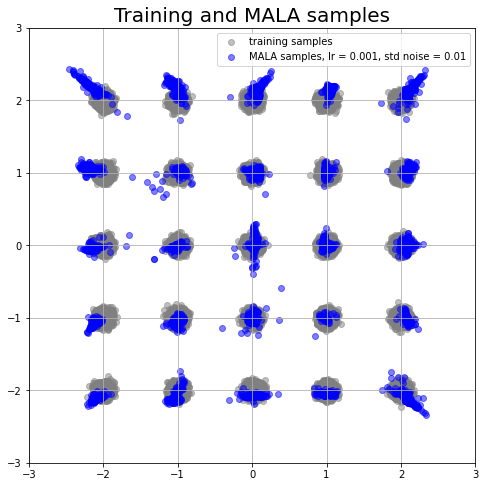

In [27]:
alpha = 1.0
step_lr = 1e-3
eps_std = 1e-2
n_steps = 50
n_batches = 1
mala_sampling_visualize(G, 
                        D,
                        X_train,  
                        path_to_save,
                        alpha = alpha,
                        scaler = scaler, 
                        batch_size_sample = batch_size_sample,
                        path_to_save_remote = None,
                        port_to_remote = None,
                        step_lr = step_lr,
                        eps_std = eps_std,
                        n_steps = n_steps,
                        n_batches = n_batches,
                        acceptance_rule='barker')

## X-try MALA with A/R step

In [34]:
def compute_log_weight(first, second, gen, dis, P, alpha, step_lr, eps_std, clip = 50.0):
    E_first, grad_first = e_grad(first, P, gen, dis, alpha, ret_e=True, e_batch = True)
        
    new_first = first - step_lr * grad_first
    
    E_second, grad_second = e_grad(second, P, gen, dis, alpha, ret_e=True, e_batch = True)
        
    new_second = second - step_lr * grad_second
    new_second = new_second.data
    
    log_energy = E_first - E_second
    vec_1 = (first - new_second)/eps_std
    vec_2 = (second - new_first)/eps_std
    
    propose_numerator = P.log_prob(vec_1).sum(dim=1)
    propose_denumerator = P.log_prob(vec_2).sum(dim=1)

    log_propose_part = propose_numerator - propose_denumerator
    
    log_weight = log_energy + log_propose_part
    log_weight = log_weight.detach()
    
    return log_weight

In [35]:
def xtry_mala_dynamics(y0, y1, gen, dis, alpha, n_steps, step_lr, eps_std, N):
    y0_arr = [y0.detach().clone()]
    y1_arr = [y1.detach().clone()]
    batch_size, z_dim = y0.shape[0], y0.shape[1]
    loc = torch.zeros(z_dim).to(gen.device)
    scale = torch.ones(z_dim).to(gen.device)
    normal = Normal(loc, scale)

    for _ in range(n_steps):
        U = torch.randint(0, N, (batch_size,)).tolist()
        Z0 = y0.unsqueeze(1).repeat(1, N, 1)
        Z1 = y1.unsqueeze(1).repeat(1, N, 1)
        noise = normal.sample([batch_size, N])
        
        E_g_j, grad_g_j = e_grad(y0, normal, gen, dis, alpha, ret_e=True)
        g_j = y0 - step_lr * grad_g_j
        g_j = g_j.data
        
        g_j_N = g_j.unsqueeze(1).repeat(1, N, 1)
        Z1 = g_j_N + eps_std*noise

        Z1[np.arange(batch_size), U, :] = y0 #y1
        
        Z0_batch = Z0.view((batch_size*N, z_dim)).detach().clone()
        Z1_batch = Z1.view((batch_size*N, z_dim)).detach().clone()
        Z0_batch.requires_grad_(True)
        Z1_batch.requires_grad_(True)
        
        log_weight = compute_log_weight(Z0_batch, Z1_batch, gen, dis, normal, alpha, step_lr, eps_std)
        log_weight = log_weight.view((batch_size, N))
        max_logs = torch.max(log_weight, dim = 1)[0].unsqueeze(-1).repeat((1, N))
        log_weight = log_weight - max_logs
        weight = torch.exp(log_weight)
        sum_weight = torch.sum(weight, dim = 1).unsqueeze(-1).repeat((1, N))
        weight = weight/sum_weight

        indices = torch.multinomial(weight, 1)
        indices = indices.repeat(1, z_dim).unsqueeze(1)
        with torch.no_grad():
            y1 = torch.gather(Z1, 1, indices).squeeze()
            y1 = y1.data
        y1.requires_grad_(True)
        y1_arr.append(y1.detach().clone())
            
        E_y1, grad_y1 = e_grad(y1, normal, gen, dis, alpha, ret_e=True)
        y0 = y1 - step_lr * grad_y1 + eps_std*noise[np.arange(batch_size), U, :]
        y0 = y0.data
        y0.requires_grad_(True)
        y0_arr.append(y0.detach().clone())
        
    return y0_arr, y1_arr

In [38]:
def xtry_mala_dynamics_ar(y0, y1, gen, dis, alpha, n_steps, step_lr, eps_std, N):

    y0_arr = [y0.detach().clone()]
    y1_arr = [y1.detach().clone()]
    batch_size, z_dim = y0.shape[0], y0.shape[1]
    loc = torch.zeros(z_dim).to(gen.device)
    scale = torch.ones(z_dim).to(gen.device)
    normal = Normal(loc, scale)

    for i in range(n_steps):
        U = torch.randint(0, N, (batch_size,)).tolist() 
        Z0 = y0.unsqueeze(1).repeat(1, N, 1)
        Z1 = y1.unsqueeze(1).repeat(1, N, 1)
        noise = normal.sample([batch_size, N])
        
        E_g_j, grad_g_j = e_grad(y0, normal, gen, dis, alpha, ret_e=True) 
        g_j = y0 - step_lr * grad_g_j
        g_j = g_j.data
        g_j_N = g_j.unsqueeze(1).repeat(1, N, 1)
        Z1 = g_j_N + eps_std*noise
        Z1[np.arange(batch_size), U, :] = y0 # y1

        Z0_batch = Z0.view((batch_size*N, z_dim)).detach().clone()
        Z1_batch = Z1.view((batch_size*N, z_dim)).detach().clone()
        Z0_batch.requires_grad_(True)
        Z1_batch.requires_grad_(True)
        
        log_weight = compute_log_weight(Z0_batch, Z1_batch, gen, dis, normal, alpha, step_lr, eps_std)
        log_weight = log_weight.view((batch_size, N))
        max_logs = torch.max(log_weight, dim = 1)[0].unsqueeze(-1).repeat((1, N))
        log_weight = log_weight - max_logs
        weight = torch.exp(log_weight)
        sum_weight = torch.sum(weight, dim = 1).unsqueeze(-1).repeat((1, N))
        weight = weight/sum_weight

        indices = torch.multinomial(weight, 1)
        # print('1', (torch.tensor(U) == indices[:, 0]).sum().item() / batch_size)
        indices = indices.repeat(1, z_dim).unsqueeze(1)
        with torch.no_grad():
            y1 = torch.gather(Z1, 1, indices).squeeze()
            y1 = y1.data 
        y1.requires_grad_(True)
        y1_arr.append(y1.detach().clone())
            
        E_y1, grad_y1 = e_grad(y1, normal, gen, dis, alpha, ret_e=True)

        new_y1 = (y1 - step_lr * grad_y1 + eps_std*noise[np.arange(batch_size), U, :]).data
        new_y1.requires_grad_(True)

        log_weight = compute_log_weight(y1, new_y1, gen, dis, normal, alpha, step_lr, eps_std)
        log_weight = log_weight.view((batch_size))
        acc_prob = torch.clamp(torch.exp(log_weight), 0, 1)
        rand = torch.rand(log_weight.shape)
        acc = (acc_prob > rand).detach()
        print(acc.sum().item() / batch_size)
        acc.requires_grad_(False)

        #y0 = new_y1
        with torch.no_grad():
            y0[acc] = new_y1[acc]
            y0[~acc] = y1[~acc]
        y0 = y0.data
        y0.requires_grad_(True)
        y0_arr.append(y0.detach().clone())
        
    return y0_arr, y1_arr

## N = 2

In [39]:
batchsize = 5000
alpha = 1.0
step_lr = 1e-3
eps_std = 1e-2
n_steps = 150
y0 = G.make_hidden(batchsize)
y0.requires_grad_(True)
y1 = G.make_hidden(batchsize)
y1.requires_grad_(True)
N = 2

y0_arr, y1_arr = xtry_mala_dynamics_ar(y0 = y0, 
                                    y1 = y1, 
                                    gen = G, 
                                    dis = D, 
                                    alpha = alpha, 
                                    n_steps = n_steps, 
                                    step_lr = step_lr, 
                                    eps_std = eps_std, 
                                    N = N)

0.6208
0.6206
0.6118
0.6184
0.6152
0.619
0.6264
0.6252
0.6266
0.6318
0.6376
0.6316
0.637
0.639
0.6452
0.6582
0.6468
0.6448
0.645
0.6556
0.661
0.661
0.666
0.6512
0.6504
0.6584
0.6634
0.6626
0.6688
0.6556
0.6692
0.6698
0.6676
0.6832
0.6654
0.6748
0.6788
0.6894
0.6628
0.6834
0.6796
0.6748
0.6804
0.6776
0.692
0.6842
0.696
0.6866
0.6796
0.695
0.691
0.6836
0.6862
0.6778
0.6934
0.6992
0.701
0.6896
0.6956
0.6956
0.6976
0.6952
0.6906
0.689
0.6978
0.7026
0.7124
0.7056
0.7104
0.703
0.7064
0.703
0.7104
0.7058
0.7046
0.7054
0.7056
0.7052
0.7048
0.7074
0.7144
0.7114
0.704
0.7174
0.697
0.7058
0.722
0.7082
0.7176
0.7072
0.7166
0.7082
0.7104
0.7004
0.7116
0.708
0.6948
0.715
0.7176
0.708
0.7236
0.72
0.7274
0.7098
0.7046
0.7174
0.7164
0.7094
0.7212
0.7106
0.7084
0.7126
0.7062
0.7232
0.7122
0.7146
0.7224
0.7112
0.7136
0.72
0.7076
0.7186
0.7138
0.7188
0.7232
0.7134
0.7228
0.7218
0.7182
0.7302
0.725
0.718
0.7224
0.7124
0.7332
0.7252
0.7224
0.7206
0.7202
0.7258
0.7092
0.7254
0.721
0.7214
0.7224
0.7298
0.7236

In [40]:
y0_last = y0_arr[-1].to(G.device)
y1_last = y1_arr[-1].to(G.device)

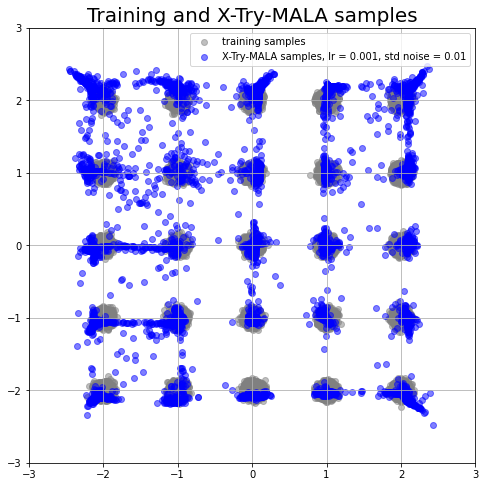

In [41]:
x_try_mala = G(y0_last).data.cpu().numpy()
mode = 'X-Try-MALA'
params = f'lr = {step_lr}, std noise = {eps_std}'
plot_fake_data_mode(x_try_mala, X_train, mode, path_to_save, 
                    scaler = scaler,
                    params = params)

## N = 5

In [43]:
batchsize = 5000
alpha = 1.0
step_lr = 1e-3
eps_std = 1e-2
n_steps = 150
y0 = G.make_hidden(batchsize)
y0.requires_grad_(True)
y1 = G.make_hidden(batchsize)
y1.requires_grad_(True)
N = 5

y0_arr, y1_arr = xtry_mala_dynamics_ar(y0 = y0, 
                                    y1 = y1, 
                                    gen = G, 
                                    dis = D, 
                                    alpha = alpha, 
                                    n_steps = n_steps, 
                                    step_lr = step_lr, 
                                    eps_std = eps_std, 
                                    N = N)

0.5928
0.5984
0.6202
0.6118
0.6174
0.6228
0.6258
0.6242
0.626
0.6186
0.638
0.631
0.6404
0.6234
0.6244
0.6472
0.6282
0.6382
0.6358
0.635
0.653
0.6418
0.6382
0.6474
0.658
0.6548
0.6416
0.6514
0.6484
0.6478
0.6616
0.6504
0.6542
0.6482
0.6556
0.6614
0.6484
0.6528
0.6576
0.656
0.656
0.6652
0.662
0.653
0.6566
0.664
0.6608
0.6696
0.67
0.6798
0.6614
0.6612
0.662
0.6664
0.651
0.6792
0.6686
0.6646
0.6614
0.6618
0.659
0.665
0.6692
0.663
0.6686
0.6658
0.6564
0.6738
0.6566
0.6712
0.6666
0.668
0.6592
0.672
0.6768
0.6724
0.6632
0.6656
0.6606
0.6658
0.6602
0.6668
0.6614
0.6694
0.6654
0.6664
0.6636
0.6674
0.6596
0.6702
0.6616
0.6644
0.6618
0.6664
0.6664
0.6628
0.6576
0.6676
0.6716
0.6722
0.6696
0.6706
0.6698
0.6604
0.6756
0.6688
0.6742
0.6686
0.672
0.6626
0.6662
0.6652
0.6706
0.6694
0.67
0.679
0.6678
0.6764
0.6666
0.6744
0.6836
0.6608
0.6676
0.6592
0.658
0.661
0.666
0.665
0.6844
0.6656
0.671
0.6722
0.677
0.6656
0.6768
0.673
0.6742
0.678
0.6672
0.6646
0.6668
0.6704
0.6792
0.6716
0.6734
0.6684
0.664
0.66

In [44]:
y0_last = y0_arr[-1].to(G.device)
y1_last = y1_arr[-1].to(G.device)

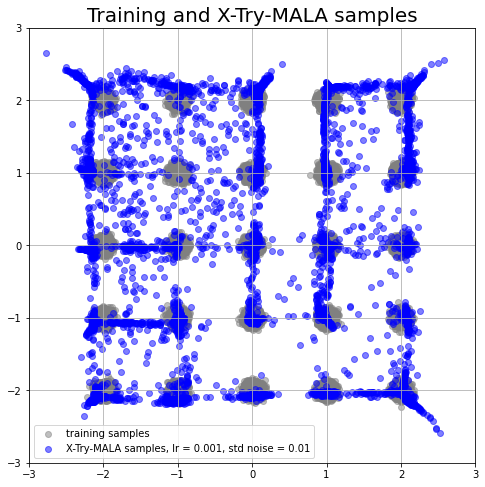

In [45]:
x_try_mala = G(y0_last).data.cpu().numpy()
mode = 'X-Try-MALA'
params = f'lr = {step_lr}, std noise = {eps_std}'
plot_fake_data_mode(x_try_mala, X_train, mode, path_to_save, 
                    scaler = scaler,
                    params = params)

## Importance weights

In [50]:
pi = torch.distributions.Normal(loc=torch.zeros(2), scale=torch.ones(2))

In [53]:
std_normal = torch.distributions.Normal(loc=torch.zeros(2), scale=torch.ones(2))

In [131]:
gamma = 1e-1
sigma = (2 * gamma)**.5


In [132]:
bs = 10000

In [133]:
z1 = pi.sample_n(bs)
z0 = z1 - gamma * (z1) + sigma * std_normal.sample_n(bs)

log_ratio_0 = pi.log_prob(z1).sum(1) + std_normal.log_prob(z0 - (z1 - gamma* (z1))).sum(1) - pi.log_prob(z0).sum(1) - std_normal.log_prob(z1 - (z0 - gamma* (z0))).sum(1)

In [134]:
torch.exp(log_ratio_0).mean(0)

tensor(1.1680)

In [135]:
z2 = z0 - gamma * (z0) + sigma * std_normal.sample_n(bs)

In [136]:
log_ratio_2 = pi.log_prob(z2).sum(1) + std_normal.log_prob(z0 - (z2 - gamma* (z2))).sum(1) - pi.log_prob(z0).sum(1) - std_normal.log_prob(z2 - (z0 - gamma* (z0))).sum(1)

In [137]:
torch.exp(log_ratio_2).mean(0)

tensor(1.1464)

In [138]:
w0 = log_ratio_0.exp() / (log_ratio_0.exp() + log_ratio_2.exp())
w2 = log_ratio_2.exp() / (log_ratio_0.exp() + log_ratio_2.exp())

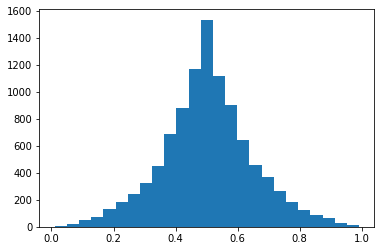

In [141]:
plt.hist(w0.tolist(), 25)
plt.show()